# Estadística Descriptiva
## Elaborado por Juan Camilo Florez Caro
## https://www.linkedin.com/in/juancamiloflorezcaro/
## Paso 1: Importar las librerias que requerimos e identificar el entorno donde nos encontramos trabajando
<b>Nota: </b> usualmente, el entorno donde trabajamos con vs code se ubica en la misma carpeta donde nos encontramos trabajando

In [55]:
import pandas as pd #Para poder trabajar con DataFrames
import numpy as np #Funciones para calculos matematicos
import os #Para conocer el sistema sobre el que trabajamos
import matplotlib.pyplot as plt #Visualización
import seaborn as sns #Visualizacion 
from scipy import stats #Funciones estadísticas

En qué Working Directory estamos trabajando?

In [ ]:
os.getcwd()

## Paso 2: Importar la información y realizar las transformaciones necesarias para poder utilizarla (DataMining)

In [66]:
#Url de los dataset https://www.kaggle.com/stefanoleone992/imdb-extensive-dataset?select=IMDb+title_principals.csv

movies = pd.read_csv(r'Datasets\IMDb Movies 2020\IMDb movies.csv')

C:\Users\1016038645\AppData\Local\Continuum\anaconda3\lib\site-packages\IPython\core\interactiveshell.py:3063: DtypeWarning: Columns (3) have mixed types.Specify dtype option on import or set low_memory=False.
  interactivity=interactivity, compiler=compiler, result=result)


In [99]:
movies.head()

,imdb_title_id,title,original_title,year,date_published,genre,duration,country,language,director,...,actors,description,avg_vote,votes,budget,usa_gross_income,worlwide_gross_income,metascore,reviews_from_users,reviews_from_critics
0,tt0000009,Miss Jerry,Miss Jerry,1970-01-01 00:00:00.000001894,1894-10-09,Romance,45,USA,None,Alexander Black,...,"Blanche Bayliss, William Courtenay, Chauncey D...",The adventures of a female reporter in the 1890s.,5.9,154,NaN,NaN,NaN,NaN,1.0,2.0
1,tt0000574,The Story of the Kelly Gang,The Story of the Kelly Gang,1970-01-01 00:00:00.000001906,1906-12-26,"Biography, Crime, Drama",70,Australia,None,Charles Tait,...,"Elizabeth Tait, John Tait, Norman Campbell, Be...",True story of notorious Australian outlaw Ned ...,6.1,589,2250.0,NaN,NaN,NaN,7.0,7.0
2,tt0001892,Den sorte drøm,Den sorte drøm,1970-01-01 00:00:00.000001911,1911-08-19,Drama,53,"Germany, Denmark",nan,Urban Gad,...,"Asta Nielsen, Valdemar Psilander, Gunnar Helse...",Two men of high rank are both wooing the beaut...,5.8,188,NaN,NaN,NaN,NaN,5.0,2.0
3,tt0002101,Cleopatra,Cleopatra,1970-01-01 00:00:00.000001912,1912-11-13,"Drama, History",100,USA,English,Charles L. Gaskill,...,"Helen Gardner, Pearl Sindelar, Miss Fielding, ...",The fabled queen of Egypt's affair with Roman ...,5.2,446,45000.0,NaN,NaN,NaN,25.0,3.0
4,tt0002130,L'Inferno,L'Inferno,1970-01-01 00:00:00.000001911,1911-03-06,"Adventure, Drama, Fantasy",68,Italy,Italian,"Francesco Bertolini, Adolfo Padovan",...,"Salvatore Papa, Arturo Pirovano, Giuseppe de L...",Loosely adapted from Dante's Divine Comedy and...,7.0,2237,NaN,NaN,NaN,NaN,31.0,14.0


Exploramos las variables básicas del dataset (Número de registros y tipos de las variables)

In [67]:
print('El dataset cuenta con '+str(len(movies))+' registros')
print('\n')
print('A continuación se muestran los tipos de los campos')
movies.dtypes

El dataset cuenta con 85855 registros


A continuación se muestran los tipos de los campos


imdb_title_id             object
title                     object
original_title            object
year                      object
date_published            object
genre                     object
duration                   int64
country                   object
language                  object
director                  object
writer                    object
production_company        object
actors                    object
description               object
avg_vote                 float64
votes                      int64
budget                    object
usa_gross_income          object
worlwide_gross_income     object
metascore                float64
reviews_from_users       float64
reviews_from_critics     float64
dtype: object

### De qué tipo son las variables que tenemos?

Como nos podemos dar cuenta al importar un dataset se predefinen las tipologias de las variables según lo que intuye pandas, no obstante con frecuencia estos requieren ajustarse, por lo cual es importante conocer los diferentes tipos de variables que podemos encontrar (Tanto para python como en R suele ser un paso que debemos realizar) 

<b>Metricas </b>
* Discretas int
* Continuas float

<b>Categoricas </b>
* Ordinales/Nominales object (En R se pueden diferenciar)
* Dicotomicas bool
* Fechas date

Así entonces, a continuación agrupamos cada una de las variables en listas según el tipo al que pertenecen:

In [68]:
#Categoricas

#Nominales y Ordinales (str / object)

cat_nominales = [
'imdb_title_id',
'title',
'original_title',
'genre',
'country',
'language',
'director',
'writer',
'production_company',
'actors',
'description']


#Fechas (date)


cat_fechas = [
'year',
'date_published']


#Metricas
#Discretas (int64)

met_discretas =[
'duration',
'votes',
'reviews_from_users',
'reviews_from_critics']

#continuas (int64)
met_continuas =[
'avg_vote',
'budget',
'usa_gross_income',
'worlwide_gross_income',
'metascore']

#### Transformación de las variables

Habitualmente, nos solemos encontrar con transformaciones adicionales que debemos realizar para poder trabajar con la iformación como lo es lidiar con valores nulos o caracteres extraños en los campos de los data set que trabajamos


In [69]:
movies['budget'].head()

0        NaN
1     $ 2250
2        NaN
3    $ 45000
4        NaN
Name: budget, dtype: object

Como nos damos cuenta, requerimos inicialmente ajustar el tipo de las variables y retirar el simbolo de '$' para poder transformar las variables con Dinero en variables metricas por lo cual a continuación se muestra como se hacen cada uno de los ajustes

* Ajuste simbolos

In [70]:
ajuste_pesos = ['budget','usa_gross_income', 'worlwide_gross_income']

for i in ajuste_pesos:
    movies[i] = movies[i].str.replace('$',"")

* Ajuste tipo de variables

In [71]:

for i in cat_fechas:
    movies[i] = pd.to_datetime(movies[i],errors = 'coerce')

for i in cat_nominales:
    movies[i] = movies[i].astype('str')

for i in met_continuas:
    movies[i] = pd.to_numeric(movies[i], errors = 'coerce', 
    downcast = 'float')

for i in met_discretas:
    movies[i] = pd.to_numeric(movies[i], errors = 'coerce', 
    downcast = 'integer')


Luego de realizar los ajustes en Simbolos y en tipo nos damos cuenta que la variable 'budget' cuenta con dtype:float32 lo cual indica que es una variable metrica continua y ya no muestra el signo "$" que anteriormente lo definia como una variable categorica

In [72]:
movies['budget'].head()

0        NaN
1     2250.0
2        NaN
3    45000.0
4        NaN
Name: budget, dtype: float32

# Paso 3: Medidas de tendencia Central

Luego de tener nuestro dataset "entendible", es cuando podemos empezar a "jugar" con la información. Para este caso como el objetivo aplicar algunos conceptos de estadistica descriptiva iniciaremos con:
* <b>Paso 3: </b>el calculo de medidas de tendencia central (Promedio, Desviación, Percentiles, Media y Moda);
* <b>Paso 4: </b>Luego elaboraremos algunos analisis gráficos tipicos para los análisis bivariados y finalmente haciendo uso de matplotlib y seaborn, 
* <b>Paso 5: </b> entendiendo que jupyter es una IDE destinada al procesamiento y analisis de la información, veremos como estas mismas visualizaciones se pueden llevar a PowerBI ( Una herramienta realmente destinada a la visualización de la información)

## Medidas de tendencia Central
A continuación usaremos la funcion <code>.describe()</code> con la cual podemos calcular estas medidas dependiendo del tipo de variables a las que nos enfrentemos
* Para las variables metricas - continuas

In [73]:
movies[met_continuas].describe()

,avg_vote,budget,usa_gross_income,worlwide_gross_income,metascore
count,85855.000000,16602.0,15321.0,3.095500e+04,13305.000000
mean,5.898590,14391354.0,19497390.0,2.252730e+07,55.896881
std,1.234906,28899202.0,48250856.0,8.882135e+07,17.784828
min,1.000000,0.0,30.0,1.000000e+00,1.000000
25%,5.200000,750000.0,93292.0,1.149520e+05,43.000000
50%,6.100000,3000000.0,1315498.0,1.108231e+06,57.000000
75%,6.800000,15000000.0,17127992.0,8.299774e+06,69.000000
max,9.900000,356000000.0,936662208.0,2.797800e+09,100.000000


<b>Dato Curioso:</b> Pero como quitamos la notación cientifica?

In [75]:
movies[met_continuas].describe().apply(lambda s: s.apply(lambda x: format(x, '.2f')))

,duration,votes,reviews_from_users,reviews_from_critics
count,85855.00,85855.00,78258.00,74058.00
mean,100.35,9493.49,46.04,27.48
std,22.55,53574.36,178.51,58.34
min,41.00,99.00,1.00,1.00
25%,88.00,205.00,4.00,3.00
50%,96.00,484.00,9.00,8.00
75%,108.00,1766.50,27.00,23.00
max,808.00,2278845.00,10472.00,999.00


* Para las variables Metricas - Discretas

In [77]:
movies[met_discretas].describe().apply(lambda s: s.apply(lambda x: format(x, '.2f')))

,duration,votes,reviews_from_users,reviews_from_critics
count,85855.00,85855.00,78258.00,74058.00
mean,100.35,9493.49,46.04,27.48
std,22.55,53574.36,178.51,58.34
min,41.00,99.00,1.00,1.00
25%,88.00,205.00,4.00,3.00
50%,96.00,484.00,9.00,8.00
75%,108.00,1766.50,27.00,23.00
max,808.00,2278845.00,10472.00,999.00


* Para las variables Categoricas - Fechas

In [78]:
movies[cat_fechas].describe()

,year,date_published
count,85854,85854
unique,167,21916
top,2017-01-01 00:00:00,2010-01-01 00:00:00
freq,3223,129
first,1930-01-01 00:00:00,1894-10-09 00:00:00
last,2020-01-01 00:00:00,2021-05-07 00:00:00


Como nos damos cuenta, la funcion <code> .describe() </code> identifica automáticamente cuando se trata de una variable categorica, frente a la cual no calcula promedios o desviaciones, unicamente muestra la Moda y el numero de veces que esta moda se repite

* Para las variables categoricas - nominales

In [79]:
movies[cat_nominales].describe()

,imdb_title_id,title,original_title,genre,country,language,director,writer,production_company,actors,description
count,85855,85855,85855,85855,85855,85855,85855,85855,85855,85855,85855
unique,85855,82094,80852,1257,4908,4378,34734,66860,32051,85730,83612
top,tt0106451,Anna,Anna,Drama,USA,English,Jesús Franco,nan,nan,nan,nan
freq,1,10,10,12543,28511,35939,87,1572,4455,69,2115


* Para variables categoricas
<b>Pregunta</b> ¿Cual es el pais que mayor número de peliculas ha p

# Paso 4: Análisis Gráfico Univariado
Entrando en el análisis gráfico es importante desde un principio conocer el objetivo de cada visualización que deseamos crear, por lo cual a continuación para hacer más dinámico el ejercicio cada visualización vendrá acompañada de una pregunta que deseamos resolver y de esta forma dar sentido a cada una de las visualizaciones construidas

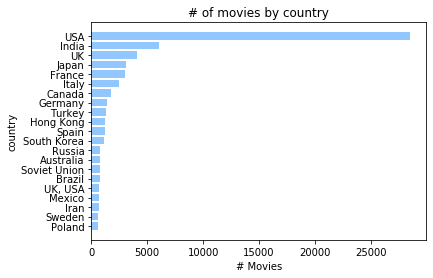

In [80]:
pivot = movies.groupby('country').agg(count = ('imdb_title_id','count'),
                                    metascore_mean= ('metascore','count')).reset_index()

# Grafico de barras -Distrubución de frecuencias  (Categoricas)
serie = pivot[pivot['count']>600].sort_values('count')
plt.style.use('seaborn-pastel')
plt.barh(serie['country'],serie['count'])
plt.title('# of movies by country')
plt.ylabel('country')
plt.xlabel('# Movies')
plt.show()

* Para variables Métricas 

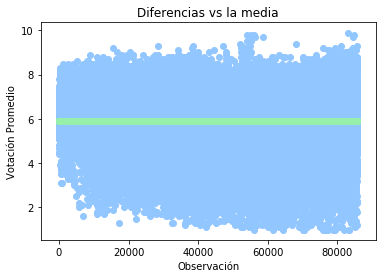

In [82]:
# Scatterplot (Diferencias vs la media (Varianza y desviación))
promedio = movies['avg_vote'].mean()

plt.style.use('seaborn-pastel')
plt.scatter(x=movies.index,y=movies['avg_vote'])
plt.scatter(x=movies.index,y=np.repeat(promedio,len(movies.index)))
plt.title('Diferencias vs la media')
plt.ylabel('Votación Promedio')
plt.xlabel('Observación')
plt.show()

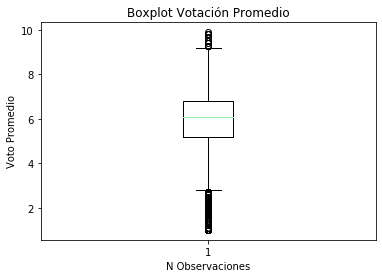

In [85]:
#Boxplots (Rangos intercuartilicos)
plt.style.use('seaborn-pastel')
plt.boxplot(movies['avg_vote'])
plt.title('Boxplot Votación Promedio')
plt.ylabel('Voto Promedio')
plt.xlabel('N Observaciones')
plt.show()

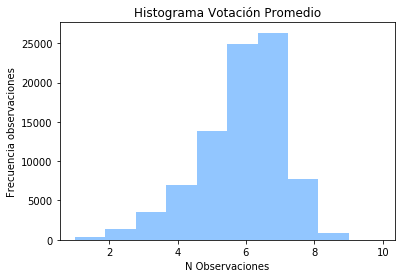

In [86]:
#Histograma

plt.style.use('seaborn-pastel')
plt.hist(movies['avg_vote'])
plt.title('Histograma Votación Promedio')
plt.ylabel('Frecuencia observaciones')
plt.xlabel('N Observaciones')
plt.show()

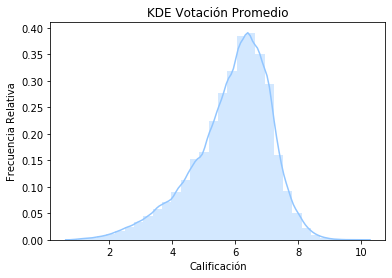

In [87]:
# Density plot / KDE (Kernel Density Estimation)
plt.style.use('seaborn-pastel')
sns.distplot(movies['avg_vote'], hist=True, kde=True, bins = 30)
plt.title('KDE Votación Promedio')
plt.ylabel('Frecuencia Relativa')
plt.xlabel('Calificación')
plt.show()

# Paso 5: Análisis Bivariado

* Metrica vs Metrica

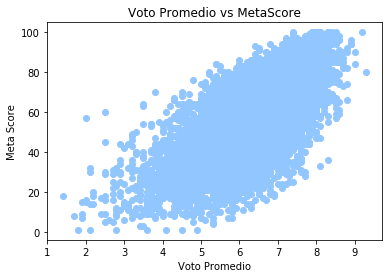

In [88]:
# ScatterPlot
movies[['avg_vote','metascore']].dropna()

plt.style.use('seaborn-pastel')
plt.scatter(x=movies['avg_vote'],y=movies['metascore'])
plt.title('Voto Promedio vs MetaScore')
plt.ylabel('Meta Score')
plt.xlabel('Voto Promedio')
plt.show()

In [ ]:
#Pair Plot https://seaborn.pydata.org/generated/seaborn.pairplot.html
# OJO: Tarda Bastante en correr ya que depende del numero de variables que estemos analizando

sns.pairplot(movies[met_continuas+met_discretas])
plt.show()

<b>Tip: </b>Si quisieramos guardar la figura en formato png y revisarlo en nuestro equipo:

In [ ]:
sns.pairplot(movies[met_continuas+met_discretas])
plt.savefig('pairplot.png')
print('almacenado exitoso!!')

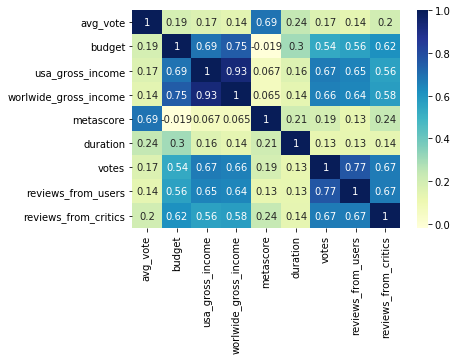

In [94]:
# Matriz de Correlaciones de Pearson
corr_matrix = movies[met_continuas+met_discretas].corr()

#HeatMap Correlaciones
sns.heatmap(corr_matrix, annot=True,cmap="YlGnBu")
plt.show()

* Categorica vs Categorica

genre genre
genre country
genre language
country genre
country country
country language
language genre
language country
language language


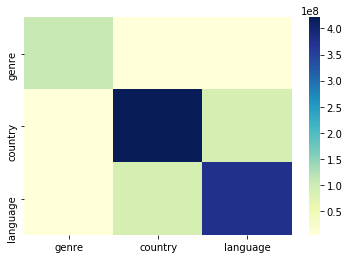

In [95]:
cat_nominales_interes = [
 'genre',
 'country',
 'language'
 ]

chisqmatrix=pd.DataFrame(movies,columns=cat_nominales_interes,index=cat_nominales_interes)

for icol in cat_nominales_interes:
    for jcol in cat_nominales_interes:
        print(icol,jcol)
        mycrosstab=pd.crosstab(movies[icol],movies[jcol])
        stat,p,dof,expected=stats.chi2_contingency(mycrosstab)
        chisqmatrix.loc[icol,jcol] = stat
 
sns.heatmap(chisqmatrix.astype('float64'),cmap="YlGnBu")
plt.show()